In [1]:
import pandas as pd
import geopandas as gpd
import os
import folium
from folium import GeoJson
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from scipy.stats import mode
import seaborn.objects as so
from IPython.display import display
from scipy.stats import f_oneway
from adjustText import adjust_text
import numpy as np


In [2]:
metro_rs_gdf_overlay = gpd.read_file("OUTPUT/metro_rs_overlay.geojson")

# All Samples Map

In [3]:
m = folium.Map(location=[29.76, -95.37], zoom_start=11, tiles="cartodbpositron")

for _, row in metro_rs_gdf_overlay.iterrows():
    sim_geo = gpd.GeoSeries([row.geometry]).__geo_interface__
    folium.GeoJson(sim_geo).add_to(m)

m

In [4]:
metro_rs_gdf_overlay

,parcel_index,unique_id,sample_id,HCAD_NUM,HCAD_NUM_clean,acct_clean,city,mail_city,state_class_y,state_class_x,...,ovr_dscr,dist_to_tcenter,dist_to_parkride,dist_to_lrt,barrier_bridges,barrier_rxings,access_tcenter_qtrmi,access_parkride_qtrmi,access_lrt_qtrmi,geometry
0,0,46b98573f1896e08e3e5c1707ec3323e,20250507_220719,1274410000036,1274410000036,1274410000036,HOUSTON,HOUSTON,Z1,A1,...,,3891.027813,28034.223082,1830.170789,3,1,0,0,0,"POLYGON ((-95.41188 29.69571, -95.41184 29.695..."
1,1,b6db04274090069e0477a40408c57246,20250507_220719,1152790430005,1152790430005,1152790430005,HOUSTON,HOUSTON,Z5,A1,...,,11519.525054,14043.114419,24681.405147,0,0,0,0,0,"POLYGON ((-95.46329 29.75035, -95.46511 29.750..."
2,2,ee373cb8abd07a20e347e348ef3f82fd,20250507_220719,1219740030067,1219740030067,1219740030067,CYPRESS,PIPE CREEK,D2,D2,...,None,79530.420627,15109.985676,107254.038992,3,0,0,0,0,"POLYGON ((-95.65774 30.00075, -95.6574 30.0007..."
3,3,a82c1d313f356923f11993a9db042dd2,20250507_220719,1416470010001,1416470010001,1416470010001,HOUSTON,HOUSTON,F1,F1,...,,6275.212624,29239.860673,18098.854009,10,1,0,0,0,"POLYGON ((-95.30768 29.80888, -95.30768 29.807..."
4,4,b11e6a055a90f73212f085e3ba9fa548,20250507_220719,0432120010343,0432120010343,0432120010343,HOUSTON,HOUSTON,X1,XV,...,,12584.606909,15542.214539,39919.065623,1,1,0,0,0,"POLYGON ((-95.23143 29.82999, -95.23122 29.829..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19185,12169,693417a14c0f34bc4d27fec95d1fc9ea,20250507_220807,1091830000006,1091830000006,1091830000006,HOUSTON,HOUSTON,Z5,A1,...,,14279.866497,11023.155850,25647.628456,0,0,0,0,0,"POLYGON ((-95.47243 29.74589, -95.47233 29.745..."
19186,12170,b6e9d55a27e83149f01dca6152f7ecb5,20250507_220807,1075090010044,1075090010044,1075090010044,HOUSTON,HOUSTON,A1,A1,...,,10871.267162,17096.301019,67250.708204,0,0,0,0,0,"POLYGON ((-95.61135 29.73859, -95.61135 29.737..."
19187,12171,dfcf4eff1c472cc010fc5a54231f436f,20250507_220807,1033130010081,1033130010081,1033130010081,HOUSTON,HOUSTON,Z3,A1,...,,8680.161174,16617.773063,33382.356170,0,0,0,0,0,"POLYGON ((-95.40457 29.92104, -95.40477 29.920..."
19188,12172,cb673dce742a6435c7711145a59c0d9b,20250507_220807,0993690000144,0993690000144,0993690000144,HOUSTON,HOUSTON,Z3,A1,...,,30536.840676,17887.639937,53340.514718,4,0,0,0,0,"POLYGON ((-95.55676 29.76678, -95.55706 29.766..."


##### lost in the columns

In [5]:
Column_guide = metro_rs_gdf_overlay.columns.tolist()
df = metro_rs_gdf_overlay

In [6]:
Column_guide

['parcel_index',
 'unique_id',
 'sample_id',
 'HCAD_NUM',
 'HCAD_NUM_clean',
 'acct_clean',
 'city',
 'mail_city',
 'state_class_y',
 'state_class_x',
 'use_dscr',
 'appr_val',
 'tot_appr_val',
 'mkt_val',
 'tot_mkt_val',
 'id',
 'OBJECTID',
 'owner',
 'subdivision',
 'address',
 'zip',
 'Shape.STArea()',
 'Shape.STLength()',
 'legal_lines',
 'acct',
 'school_dist',
 'Neighborhood_Code',
 'Neighborhood_Grp',
 'Market_Area_1',
 'Market_Area_1_Dscr',
 'Market_Area_2',
 'Market_Area_2_Dscr',
 'econ_area',
 'econ_bld_class',
 'center_code',
 'yr_impr',
 'acreage',
 'land_val',
 'bld_val',
 'x_features_val',
 'ag_val',
 'assessed_val',
 'num',
 'use_cd',
 'inf_cd',
 'inf_dscr',
 'ovr_dscr',
 'dist_to_tcenter',
 'dist_to_parkride',
 'dist_to_lrt',
 'barrier_bridges',
 'barrier_rxings',
 'access_tcenter_qtrmi',
 'access_parkride_qtrmi',
 'access_lrt_qtrmi',
 'geometry']

# Analysis - Overlay

### lmplot: Distance to Access vs. Count within ¼-Mile Buffer

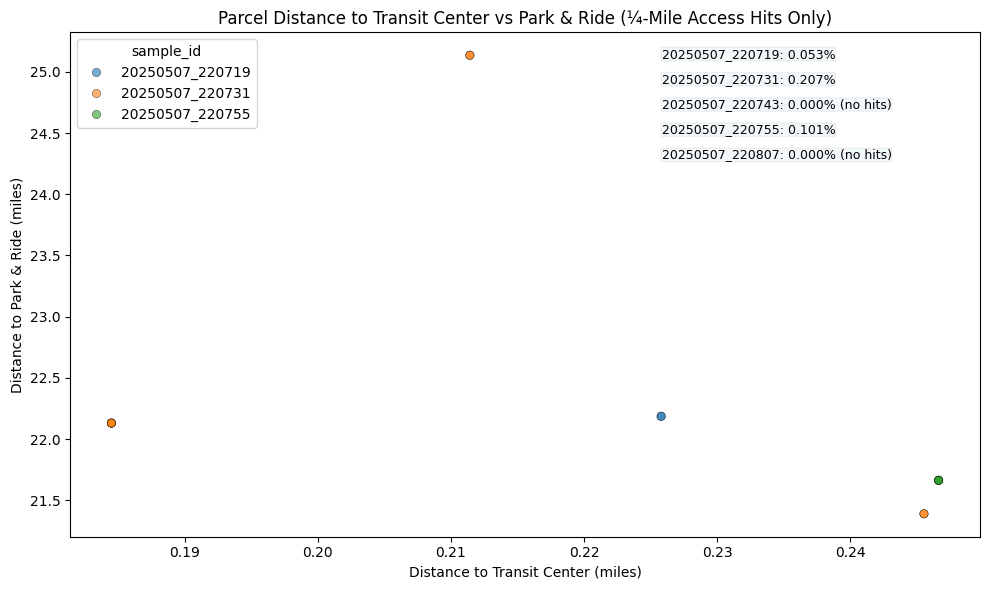

In [7]:
# Convert distances to miles
df["dist_to_tcenter_mi"] = df["dist_to_tcenter"] / 1609.34
df["dist_to_parkride_mi"] = df["dist_to_parkride"] / 1609.34

# Barrier total
df["total_barriers"] = df["barrier_bridges"] + df["barrier_rxings"]

# Filter parcels with any access hit
df_hits = df[
    (df["access_tcenter_qtrmi"] > 0) |
    (df["access_parkride_qtrmi"] > 0)
].copy()

# Sample-wise buffer hit percentages
all_counts = df["sample_id"].value_counts().sort_index()
hit_counts = df_hits["sample_id"].value_counts().reindex(all_counts.index).fillna(0)
hit_pct = (hit_counts / all_counts * 100).round(3)  # percent with 3 decimals

# Plot
plt.figure(figsize=(10, 6))
scatter = sns.scatterplot(
    data=df_hits,
    x="dist_to_tcenter_mi",
    y="dist_to_parkride_mi",
    hue="sample_id",
    alpha=0.6,
    edgecolor="black",
    linewidth=0.4
)

# Annotate sample percentages
y_anchor = 0.95
for sample, pct in hit_pct.items():
    label = f"{sample}: {pct:.3f}%"
    if pct == 0:
        label += " (no hits)"
    plt.text(
        .65, y_anchor,
        label,
        transform=plt.gca().transAxes,
        fontsize=9,
        ha="left",
        bbox=dict(boxstyle="round,pad=0.02", alpha=0.05)
    )
    y_anchor -= 0.05

# Labels
plt.title("Parcel Distance to Transit Center vs Park & Ride (¼-Mile Access Hits Only)")
plt.xlabel("Distance to Transit Center (miles)")
plt.ylabel("Distance to Park & Ride (miles)")
plt.tight_layout()
plt.show()

Observation: 

Less than 1% hits to a Park & Ride or Transit Center when considering random sampling of all parcels within the Service Area

### stripplot: Conditional Means for Distance to Access Points

In [8]:
# Convert distance to miles
df["dist_to_tcenter_mi"] = df["dist_to_tcenter"] / 1609.34
df["dist_to_parkride_mi"] = df["dist_to_parkride"] / 1609.34
df["dist_to_lrt_mi"] = df["dist_to_lrt"] / 1609.34

# Melt distance columns
dist_vars = ["dist_to_tcenter_mi", "dist_to_parkride_mi", "dist_to_lrt_mi"]
df_melted = df.melt(id_vars=["sample_id"], value_vars=dist_vars, 
                    var_name="access_type", value_name="distance_mi")

# Rename for cleaner labels
df_melted["access_type"] = df_melted["access_type"].str.replace("_mi", "").str.replace("dist_to_", "").str.upper()


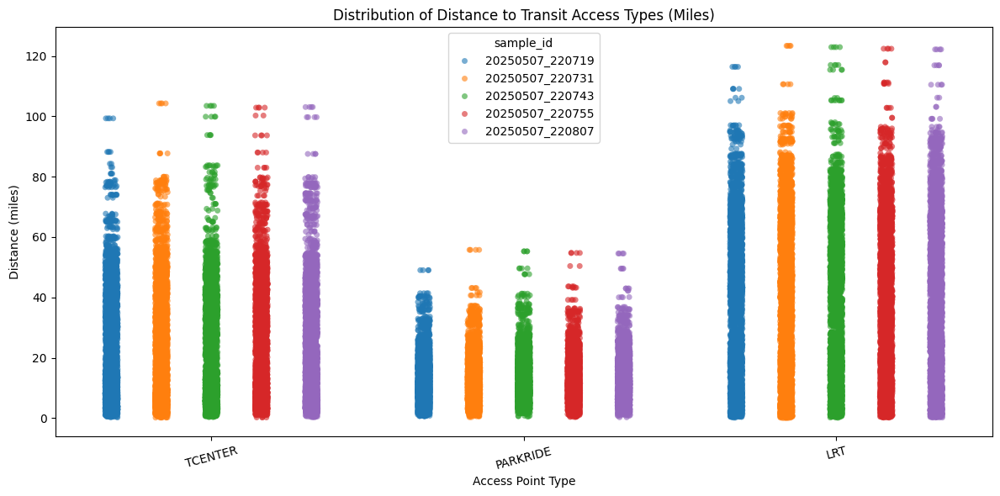

In [9]:
plt.figure(figsize=(12, 6))
sns.stripplot(
    data=df_melted,
    x="access_type",
    y="distance_mi",
    hue="sample_id",
    dodge=True,
    alpha=0.6,
    jitter=True
)
plt.title("Distribution of Distance to Transit Access Types (Miles)")
plt.xlabel("Access Point Type")
plt.ylabel("Distance (miles)")
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()

In [10]:
# Summary stats collection
summary_rows = []

for (sample, atype), group in df_melted.groupby(["sample_id", "access_type"]):
    summary_rows.append({
        "sample_id": sample,
        "access_type": atype,
        "mean_mi": group["distance_mi"].mean(),
        "median_mi": group["distance_mi"].median(),
        "mode_mi": mode(group["distance_mi"], keepdims=True).mode[0],
        "std_mi": group["distance_mi"].std()
    })

summary_df = pd.DataFrame(summary_rows)

# Optional: round for readability
summary_df = summary_df.round(2)

In [11]:
display(summary_df.sort_values(by=["access_type", "sample_id"]))

,sample_id,access_type,mean_mi,median_mi,mode_mi,std_mi
0,20250507_220719,LRT,38.67,39.52,8.36,25.21
3,20250507_220731,LRT,38.81,36.83,1.38,26.16
6,20250507_220743,LRT,37.70,36.39,12.01,25.27
9,20250507_220755,LRT,38.02,35.74,21.28,25.11
12,20250507_220807,LRT,39.69,38.51,34.82,25.68
1,20250507_220719,PARKRIDE,13.23,12.11,17.51,7.33
4,20250507_220731,PARKRIDE,13.03,11.64,1.85,7.42
7,20250507_220743,PARKRIDE,13.24,11.77,12.65,7.46
10,20250507_220755,PARKRIDE,12.63,11.52,10.73,7.16
13,20250507_220807,PARKRIDE,12.95,11.65,11.20,7.46


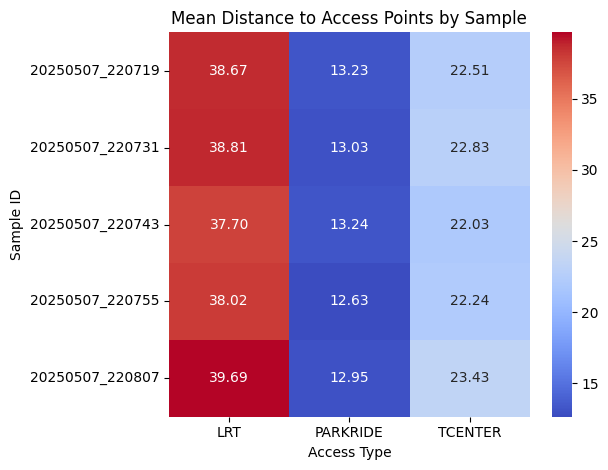

In [12]:
pivot_table = summary_df.pivot(index="sample_id", columns="access_type", values="mean_mi")
sns.heatmap(pivot_table, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Mean Distance to Access Points by Sample")
plt.ylabel("Sample ID")
plt.xlabel("Access Type")
plt.tight_layout()
plt.show()

In [13]:
# Group distances by access type
grouped = df_melted.groupby("access_type")["distance_mi"].apply(list)

# Run ANOVA
f_stat, p_val = f_oneway(*grouped)

print("One-Way ANOVA Across Access Types (Combined Samples)")
print(f"F-statistic: {f_stat:.4f}")
print(f"P-value: {p_val:.4g}")

if p_val < 0.05:
    print("→ Significant difference in means between access types (p < 0.05)")
else:
    print("→ No significant difference detected (p ≥ 0.05)")

One-Way ANOVA Across Access Types (Combined Samples)
F-statistic: 9178.9830
P-value: 0
→ Significant difference in means between access types (p < 0.05)


In [14]:
print("One-Way ANOVA Per Sample")
anova_results = []

for sample_id, group in df_melted.groupby("sample_id"):
    grouped = group.groupby("access_type")["distance_mi"].apply(list)
    if len(grouped) == 3:  # Ensure all access types are present
        f_stat, p_val = f_oneway(*grouped)
        anova_results.append({
            "sample_id": sample_id,
            "F_statistic": round(f_stat, 4),
            "p_value": round(p_val, 4),
            "significant": p_val < 0.05
        })

anova_df = pd.DataFrame(anova_results)
display(anova_df)

One-Way ANOVA Per Sample


,sample_id,F_statistic,p_value,significant
0,20250507_220719,1852.4098,0.0,True
1,20250507_220731,1792.9657,0.0,True
2,20250507_220743,1716.4347,0.0,True
3,20250507_220755,1910.2913,0.0,True
4,20250507_220807,1920.1456,0.0,True


There is a statistically significant difference in mean distances among the access types (TCENTER, PARKRIDE, LRT) — both overall and within each sample.

In [15]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd

In [16]:
# Run Tukey HSD test on all data
tukey_result = pairwise_tukeyhsd(
    endog=df_melted["distance_mi"],
    groups=df_melted["access_type"],
    alpha=0.05
)

print(tukey_result)

   Multiple Comparison of Means - Tukey HSD, FWER=0.05   
 group1   group2  meandiff p-adj  lower    upper   reject
---------------------------------------------------------
     LRT PARKRIDE -25.5568   0.0 -26.0034 -25.1101   True
     LRT  TCENTER -15.9675   0.0 -16.4141 -15.5208   True
PARKRIDE  TCENTER   9.5893   0.0   9.1426  10.0359   True
---------------------------------------------------------


In [17]:
# Convert Tukey result to DataFrame
tukey_df = pd.DataFrame(data=tukey_result.summary().data[1:], columns=tukey_result.summary().data[0])
display(tukey_df)

,group1,group2,meandiff,p-adj,lower,upper,reject
0,LRT,PARKRIDE,-25.5568,0.0,-26.0034,-25.1101,True
1,LRT,TCENTER,-15.9675,0.0,-16.4141,-15.5208,True
2,PARKRIDE,TCENTER,9.5893,0.0,9.1426,10.0359,True


A Tukey post hoc analysis was conducted following a significant one-way ANOVA, revealing that mean distances to all transit access types statistically differ significantly from one another.

Observation

Park & Rides serve more peripheral areas, while LRT stations and Transit Centers tend to be located closer to developed urban cores or high-demand parcels.

Notes: 
- Transit Centers are on average 8.76 miles closer than Park & Rides
- LRT access is 15.39-mile average distance closer to properties than Transit Center

### stripplot: Barriers to Accessibility

By exploring the correlation between barriers (railroad crossings and bridges) to access to transit centers or park and ride facilities, one can establish a validated hypothesis regarding the trend. 

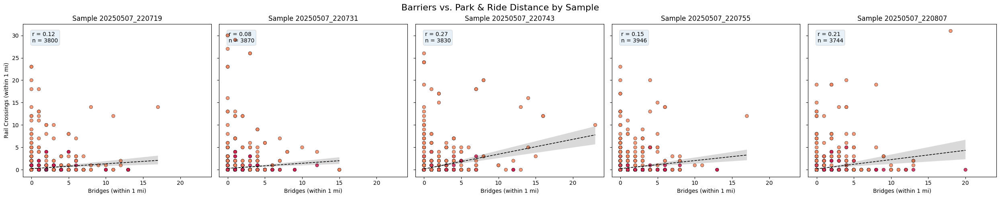

In [18]:
# Ensure distance bin exists
df["dist_to_parkride_cat"] = pd.cut(
    df["dist_to_parkride"],
    bins=[0, 1609, 16090, float("inf")],
    labels=["<1 mi", "1–10 mi", "30+ mi"]
)

# Gradient color palette
distance_palette = dict(zip(
    ["<1 mi", "1–10 mi", "30+ mi"],
    sns.color_palette("rocket", 3)
))

# Setup
sample_ids = df["sample_id"].unique()
fig, axes = plt.subplots(1, len(sample_ids), figsize=(5 * len(sample_ids), 5), sharex=True, sharey=True)

# Plot each sample
for ax, sample in zip(axes, sample_ids):
    subset = df[df["sample_id"] == sample]

    # Scatter with color by distance category
    sns.scatterplot(
        data=subset,
        x="barrier_bridges",
        y="barrier_rxings",
        hue="dist_to_parkride_cat",
        palette=distance_palette,
        alpha=0.6,
        edgecolor="black",
        linewidth=0.4,
        ax=ax,
        legend=False
    )

    # Regression line
    sns.regplot(
        data=subset,
        x="barrier_bridges",
        y="barrier_rxings",
        scatter=False,
        ax=ax,
        line_kws={"color": "black", "linewidth": 1.2, "linestyle": "--"}
    )

    # Calculate and display Pearson r and sample size
    try:
        r_val, _ = pearsonr(subset["barrier_bridges"], subset["barrier_rxings"])
        r_val = round(r_val, 2)
        n_val = len(subset)
        ax.text(0.05, 0.95, f"r = {r_val}\nn = {n_val}", transform=ax.transAxes,
                fontsize=10, verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.1))
    except Exception as e:
        ax.text(0.05, 0.95, f"r = N/A\nn = {len(subset)}", transform=ax.transAxes,
                fontsize=10, verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.1))

    ax.set_title(f"Sample {sample}")
    ax.set_xlabel("Bridges (within 1 mi)")
    if ax == axes[0]:
        ax.set_ylabel("Rail Crossings (within 1 mi)")
    else:
        ax.set_ylabel("")

# Shared legend and final layout
handles, labels = ax.get_legend_handles_labels()
plt.suptitle("Barriers vs. Park & Ride Distance by Sample", fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.88)
plt.show()


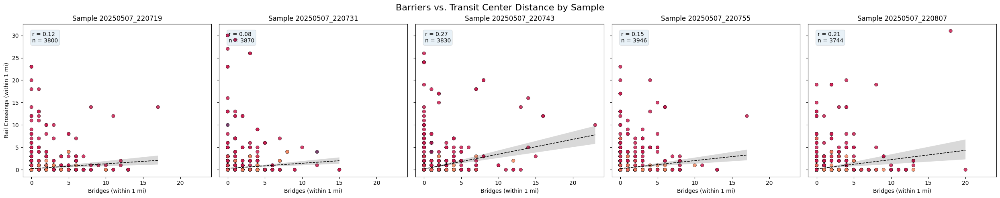

In [19]:
# Ensure distance bin exists
df["dist_to_tcenter_cat"] = pd.cut(
    df["dist_to_tcenter"],
    bins=[0, 1609, 16090, float("inf")],
    labels=["<1 mi", "1–10 mi", "30+ mi"]
)

# Gradient color palette
distance_palette = dict(zip(
    ["<1 mi", "1–10 mi", "30+ mi"],
    sns.color_palette("rocket", 3)
))

# Setup
sample_ids = df["sample_id"].unique()
fig, axes = plt.subplots(1, len(sample_ids), figsize=(5 * len(sample_ids), 5), sharex=True, sharey=True)

# Plot each sample
for ax, sample in zip(axes, sample_ids):
    subset = df[df["sample_id"] == sample]

    # Scatter with color by distance category
    sns.scatterplot(
        data=subset,
        x="barrier_bridges",
        y="barrier_rxings",
        hue="dist_to_tcenter_cat",
        palette=distance_palette,
        alpha=0.6,
        edgecolor="black",
        linewidth=0.4,
        ax=ax,
        legend=False
    )

    # Regression line
    sns.regplot(
        data=subset,
        x="barrier_bridges",
        y="barrier_rxings",
        scatter=False,
        ax=ax,
        line_kws={"color": "black", "linewidth": 1.2, "linestyle": "--"}
    )

    # Calculate and display Pearson r and sample size
    try:
        r_val, _ = pearsonr(subset["barrier_bridges"], subset["barrier_rxings"])
        r_val = round(r_val, 2)
        n_val = len(subset)
        ax.text(0.05, 0.95, f"r = {r_val}\nn = {n_val}", transform=ax.transAxes,
                fontsize=10, verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.1))
    except Exception as e:
        ax.text(0.05, 0.95, f"r = N/A\nn = {len(subset)}", transform=ax.transAxes,
                fontsize=10, verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.1))

    ax.set_title(f"Sample {sample}")
    ax.set_xlabel("Bridges (within 1 mi)")
    if ax == axes[0]:
        ax.set_ylabel("Rail Crossings (within 1 mi)")
    else:
        ax.set_ylabel("")

# Shared legend and final layout
handles, labels = ax.get_legend_handles_labels()
plt.suptitle("Barriers vs. Transit Center Distance by Sample", fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.88)
plt.show()


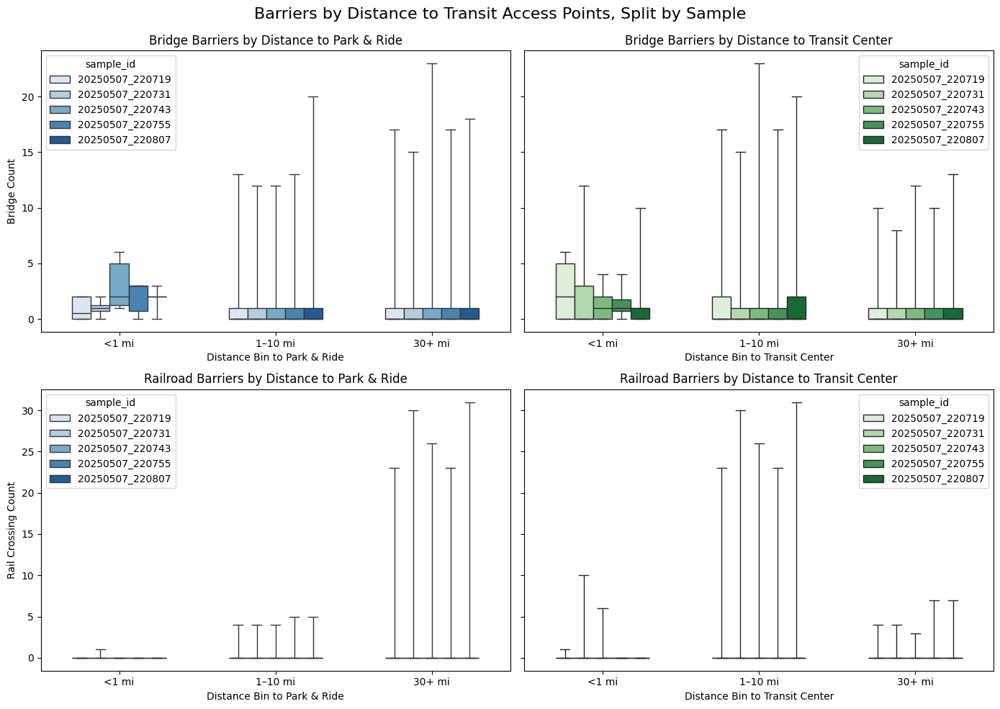

In [20]:
# Create individual barrier columns if not already present
# Bins for distance categories
bins = [0, 1609, 16090, float("inf")]
labels = ["<1 mi", "1–10 mi", "30+ mi"]
df["bin_parkride"] = pd.cut(df["dist_to_parkride"], bins=bins, labels=labels)
df["bin_tcenter"] = pd.cut(df["dist_to_tcenter"], bins=bins, labels=labels)

# Setup side-by-side plots for bridges and rail crossings separately
fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharey='row')

# Barrier: Bridges by distance to Park & Ride
sns.boxplot(
    data=df,
    x="bin_parkride",
    y="barrier_bridges",
    hue="sample_id",
    ax=axes[0, 0],
    palette="Blues",
    whis=[0, 100], 
    width=.6
)
axes[0, 0].set_title("Bridge Barriers by Distance to Park & Ride")
axes[0, 0].set_xlabel("Distance Bin to Park & Ride")
axes[0, 0].set_ylabel("Bridge Count")

# Barrier: Rail crossings by distance to Park & Ride
sns.boxplot(
    data=df,
    x="bin_parkride",
    y="barrier_rxings",
    hue="sample_id",
    ax=axes[1, 0],
    palette="Blues",
    whis=[0, 100], 
    width=.6
)
axes[1, 0].set_title("Railroad Barriers by Distance to Park & Ride")
axes[1, 0].set_xlabel("Distance Bin to Park & Ride")
axes[1, 0].set_ylabel("Rail Crossing Count")

# Barrier: Bridges by distance to Transit Center
sns.boxplot(
    data=df,
    x="bin_tcenter",
    y="barrier_bridges",
    hue="sample_id",
    ax=axes[0, 1],
    palette="Greens",
    whis=[0, 100], 
    width=.6
)
axes[0, 1].set_title("Bridge Barriers by Distance to Transit Center")
axes[0, 1].set_xlabel("Distance Bin to Transit Center")
axes[0, 1].set_ylabel("")

# Barrier: Rail crossings by distance to Transit Center
sns.boxplot(
    data=df,
    x="bin_tcenter",
    y="barrier_rxings",
    hue="sample_id",
    ax=axes[1, 1],
    palette="Greens",
    whis=[0, 100], 
    width=.6
)
axes[1, 1].set_title("Railroad Barriers by Distance to Transit Center")
axes[1, 1].set_xlabel("Distance Bin to Transit Center")
axes[1, 1].set_ylabel("")

plt.suptitle("Barriers by Distance to Transit Access Points, Split by Sample", fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

Observation: 

Parcels farther from Park & Rides are slightly more likely to encounter more physical barriers

Park & Ride facilities may be more likely placed near freeways or rail corridors, which already have higher bridge and railroad density.

Notes: 
- Distance doesn't account for network impedance
- The barrier count is within a fixed radius 

# Analysis - Metrics

#### data prep

In [21]:
# Load the lookup table from the 'State_Class' tab
state_class_lookup = pd.read_excel("../REF/HCAD_RealPropertyCodes.xlsx", sheet_name="State Class")

# Preview structure
#display(state_class_lookup.head())

In [22]:
# Merge on state_class_y
df = df.merge(
    state_class_lookup.rename(columns={"Code": "state_class_y", "Description": "state_class_y_desc"}),
    on="state_class_y",
    how="left"
)

# Merge on state_class_x (if still present)
if "state_class_x" in df.columns:
    df = df.merge(
        state_class_lookup.rename(columns={"Code": "state_class_x", "Description": "state_class_x_desc"}),
        on="state_class_x",
        how="left"
    )

In [23]:
# Convert year to numeric
df["yr_impr"] = pd.to_numeric(df["yr_impr"], errors="coerce")

### Land Use Lookup match

In [24]:
# LBCS mapping dictionary: maps Type-Code to (Activity Code, Generalized Code)
lbcs_mapping = {
    1000: (1100, 1000), 1001: (1100, 1000), 1002: (1100, 1000), 1003: (1100, 1000),
    1006: (1100, 1000), 2000: (1100, 1000), 2001: (1100, 1000), 2002: (1100, 1000),
    2003: (1100, 1000), 3100: (1100, 1000), 1105: (4331, 4000), 1106: (4331, 4000),
    4546: (4314, 4000), 4600: (9000, 9000), 4700: (4340, 4000), 4702: (4340, 4000),
    4705: (4340, 4000), 4706: (4340, 4000), 4710: (4340, 4000), 4712: (4340, 4000),
    4713: (4340, 4000), 4715: (4340, 4000), 4720: (4340, 4000), 4730: (4300, 4000),
    4733: (4311, 4000), 4735: (4300, 4000), 4740: (4300, 4000), 4742: (4310, 4000),
    4743: (4312, 4000), 4745: (4311, 4000), 4747: (4300, 4000), 4749: (4300, 4000),
    4750: (4300, 4000), 4752: (4330, 4000), 4753: (4332, 4000), 4755: (4330, 4000),
    4756: (4330, 4000), 4757: (4300, 4000), 4759: (4300, 4000), 9003: (8100, 8000),
    9007: (8100, 8000), 9011: (8300, 8000), 9015: (8300, 8000), 9019: (8100, 8000),
    9023: (8100, 8000), 9027: (8100, 8000), 9031: (8200, 8000), 9035: (8200, 8000),
    9039: (8200, 8000), 9043: (8100, 8000), 9047: (8100, 8000), 9051: (8100, 8000),
    9055: (8100, 8000), 9059: (8100, 8000), 9063: (8100, 8000), 9067: (8100, 8000),
    9071: (8100, 8000), 9075: (8100, 8000), 9079: (8100, 8000), 9083: (8200, 8000),
    4930: (7160, 7000), 8001: (2000,2000), 8002: (2000,2000), 8003: (2000,2000)
}

In [25]:
# Use_cd --> LBCS Mapping function
def map_lbcs(code):
    return lbcs_mapping.get(code, (None, None))

In [26]:
landusecode_lookup = pd.read_excel("../REF/HCAD_RealPropertyCodes.xlsx",
                                   sheet_name="Bldg Type"
                                   )
landusecode_lookup = landusecode_lookup[
    landusecode_lookup["Code Index"] == "desc_r_15_land_usecode"
]

In [27]:
landusecode_lookup[["LBCS_Activity_Code", "LBCS_Generalized_Code"]] = landusecode_lookup["Type-Code"].apply(map_lbcs).apply(pd.Series)

In [28]:
# Normalize descriptions for keyword matching
landusecode_lookup["Description_lower"] = landusecode_lookup["Description"].str.lower()

# Define keyword-based rules for fallback mapping
keyword_rules = [
    ("easement", (4314, 4000)),
    ("right of way", (4331, 4000)),
    ("submerged", (9000, 9000)),
    ("non-usable", (9000, 9000)),
    ("usable", (4314, 4000)),
    ("utility",(4300,4000)),
    ("railroad",(5400,5000)),
    ("streets",(5210,5000)),
    ("mobile home",(5210,5000)),
    ("pipeline",(9000,9000)),
    ("port",(5520,5000)),
    ("medical",(4500,4000)),
    ("industrial",(3000,3000)),
    ("interest",(9000,9000)),
    ("nominal",(9000,9000)),
    ("neighborhood",(4331,4000)),
    ("open space",(9000,9000)),
    ("residual",(9000,9000)),
    ("value",(9000,9000)),
    ("commercial",(2000,2000)),
    ("udi",(9000,9000)),
    ("mineral",(3000,3000))
]

In [29]:
# Apply only to rows with missing Activity Code
missing_mask = landusecode_lookup["LBCS_Activity_Code"].isna()

for keyword, (activity_code, general_code) in keyword_rules:
    keyword_mask = landusecode_lookup["Description_lower"].str.contains(keyword, na=False)
    combined_mask = missing_mask & keyword_mask
    
    landusecode_lookup.loc[combined_mask, "LBCS_Activity_Code"] = activity_code
    landusecode_lookup.loc[combined_mask, "LBCS_Generalized_Code"] = general_code

In [30]:
df["use_cd"] = df["use_cd"].astype(str)
landusecode_lookup["Type-Code"] = landusecode_lookup["Type-Code"].astype(str)

In [31]:
# Merge on code-type/use_cd
df = df.merge(
    landusecode_lookup[["Type-Code", "LBCS_Generalized_Code"]],
    how="left",
    left_on="use_cd",
    right_on="Type-Code"
)

In [32]:
landusecode_lookup

,Code Index,Type-Code,Description,LBCS_Activity_Code,LBCS_Generalized_Code,Description_lower
614,desc_r_15_land_usecode,1000,Res Vacant Table Value,1100.0,1000.0,res vacant table value
615,desc_r_15_land_usecode,1001,Res Improved Table Value,1100.0,1000.0,res improved table value
616,desc_r_15_land_usecode,1002,Res Vacant Table Value (Res. Use),1100.0,1000.0,res vacant table value (res. use)
617,desc_r_15_land_usecode,1003,Res Improved Table Value (Res. Use),1100.0,1000.0,res improved table value (res. use)
618,desc_r_15_land_usecode,1006,Condo Land,1100.0,1000.0,condo land
...,...,...,...,...,...,...
712,desc_r_15_land_usecode,9910,Mkt Value of Ag Land,9000.0,9000.0,mkt value of ag land
713,desc_r_15_land_usecode,9920,Mkt Value of SV Land,9000.0,9000.0,mkt value of sv land
714,desc_r_15_land_usecode,9930,Mkt Value of NV Land,9000.0,9000.0,mkt value of nv land
715,desc_r_15_land_usecode,9998,Nominal Value Improved,9000.0,9000.0,nominal value improved


### Column Picker for analysis

In [33]:
# Pick relevant columns
cols = ["acct_clean","yr_impr", "acreage", "tot_appr_val", "Market_Area_1_Dscr", "state_class_y_desc", "LBCS_Generalized_Code"]
df_corr = df[cols].copy().dropna()

In [34]:
df_corr

,acct_clean,yr_impr,acreage,tot_appr_val,Market_Area_1_Dscr,state_class_y_desc,LBCS_Generalized_Code
0,1274410000036,1983.0,0.0000,132274.0,1H Condo - South of Braeswood inside Loop 610,Condo - Apartment Conversion,1000.0
1,1152790430005,1981.0,0.0000,330937.0,1H High Rise General,Condo - High Rise,1000.0
3,1416470010001,1975.0,7.7150,3703153.0,1E Liberty/Kashmere/Houston/Croyden Gardens Areas,"Real, Commercial",2000.0
5,0450260010007,2002.0,4.9979,744700.0,ISD 26 - Tomball ISD,"Real, Residential, Single-Family",1000.0
6,0450260010007,2002.0,4.9979,744700.0,ISD 26 - Tomball ISD,"Real, Residential, Single-Family",1000.0
...,...,...,...,...,...,...,...
19184,1100100000002,1965.0,0.0000,115505.0,ISD 25 - Spring Branch Condos,Condo - Townhouse (2+ stories),1000.0
19185,1091830000006,1975.0,0.0000,567431.0,1H High Rise General,Condo - High Rise,1000.0
19186,1075090010044,1980.0,0.0000,179698.0,1A Ashford/Briar Hills Areas,"Real, Residential, Single-Family",1000.0
19187,1033130010081,1971.0,0.0000,98083.0,"ISD 09 - Outside Airport Tiers, East of I-45",Condo - Townhouse (2+ stories),1000.0


### Correlation Chart

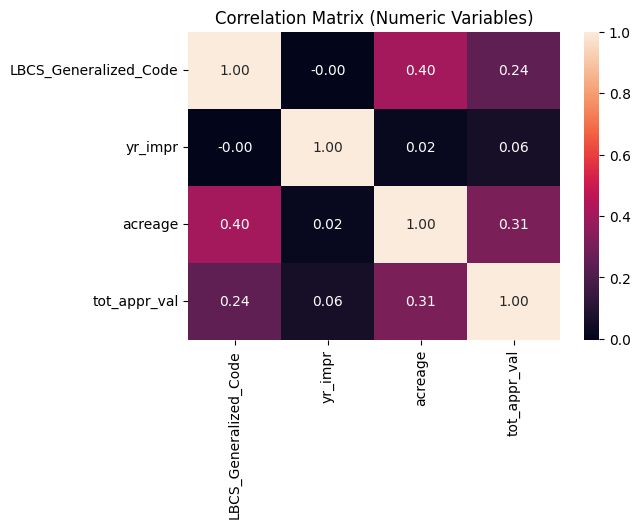

In [35]:
# Compute numeric correlations
corr_matrix = df_corr[["LBCS_Generalized_Code","yr_impr", "acreage", "tot_appr_val"]].corr()

# Plot heatmap
plt.figure(figsize=(6, 4))
sns.heatmap(corr_matrix, annot=True, cmap="rocket", fmt=".2f")
plt.title("Correlation Matrix (Numeric Variables)")
plt.show()

### Housing v Commercial Actual Assessed Value

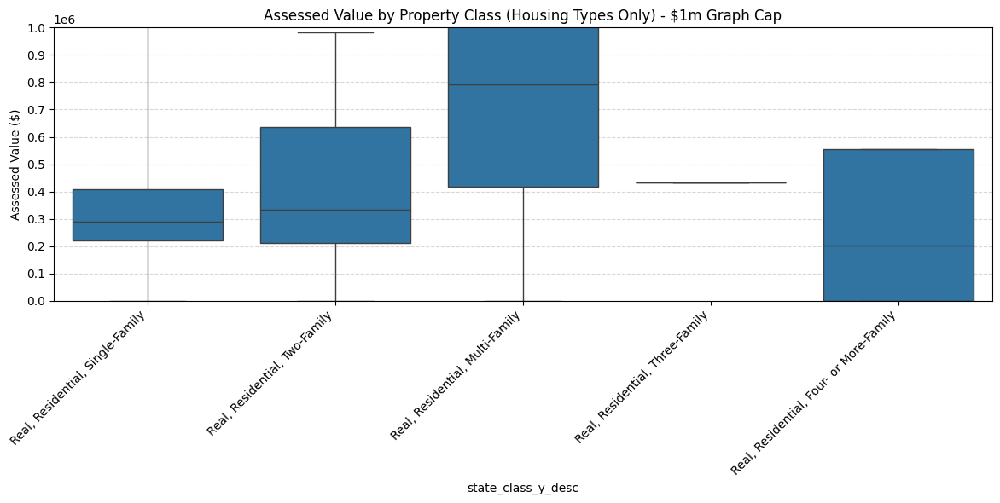

In [36]:
# Boxplot of assessed value by state class (filtered to classes containing 'Family')
housing_df = df_corr[df_corr["state_class_y_desc"].str.contains("Family", case=False, na=False)]

plt.figure(figsize=(12, 6))
sns.boxplot(
    data=housing_df, 
    x="state_class_y_desc", 
    y="tot_appr_val",
    whis=[0,100]
    )
plt.xticks(rotation=45, ha="right")
plt.title("Assessed Value by Property Class (Housing Types Only) - $1m Graph Cap")
plt.ylabel("Assessed Value ($)")
plt.ylim(0, 1_000_000)  # cap y-axis at $1M
plt.yticks(ticks=range(0, 1_000_001, 100_000))  # grid every $100k
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

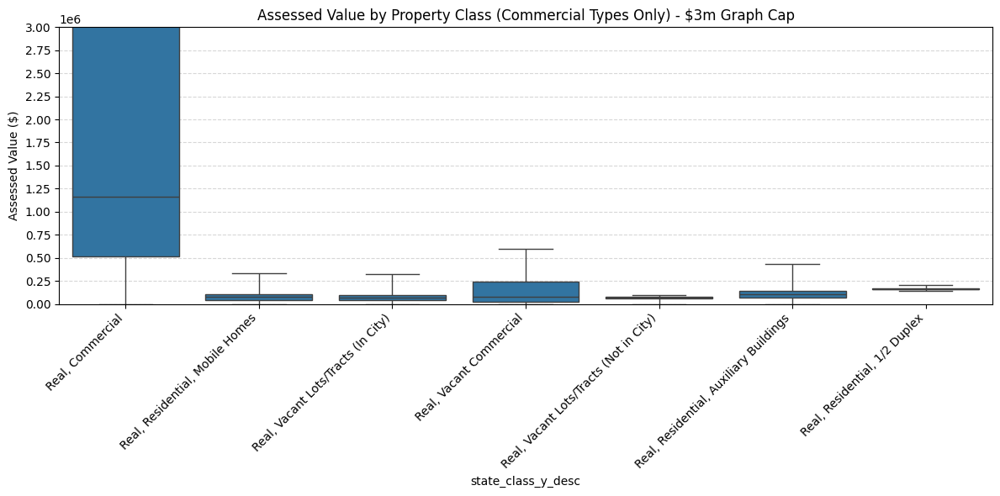

In [37]:
# Boxplot of assessed value by state class (filtered to classes containing 'Real')
real_df = df_corr[
    df_corr["state_class_y_desc"].str.contains("Real", case=False, na=False) &
    ~df_corr["state_class_y_desc"].str.contains("Family", case=False, na=False) &
    ~df_corr["state_class_y_desc"].str.contains("Industrial", case=False, na=False) &
    ~df_corr["state_class_y_desc"].str.contains("Land", case=False, na=False)
]

plt.figure(figsize=(12, 6))
sns.boxplot(
    data=real_df, 
    x="state_class_y_desc", 
    y="tot_appr_val",
    whis=[0,100]
    )
plt.xticks(rotation=45, ha="right")
plt.title("Assessed Value by Property Class (Commercial Types Only) - $3m Graph Cap")
plt.ylabel("Assessed Value ($)")
plt.ylim(0, 3_000_000)  # cap y-axis at $1M
plt.yticks(ticks=range(0, 3_000_001, 250_000))  # grid every $250k
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

# Variable Regression Model

In [41]:
import statsmodels.api as sm
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error


In [42]:
reg_df = df_corr.copy()

## M3 - Random Forest

In [43]:
# Model Run 03

# Step 1: Clean and prepare data
df = df_corr.copy()
df["tot_appr_val"] = pd.to_numeric(df["tot_appr_val"], errors="coerce")
df["yr_impr"] = pd.to_numeric(df["yr_impr"], errors="coerce")
df["acreage"] = pd.to_numeric(df["acreage"], errors="coerce")
df["state_class_y_desc"] = df["state_class_y_desc"].astype(str)
df["LBCS_Generalized_Code"] = df["LBCS_Generalized_Code"].astype(str)
df = df.dropna(subset=["tot_appr_val", "yr_impr", "acreage", "state_class_y_desc", "LBCS_Generalized_Code"])
df["log_val"] = np.log1p(df["tot_appr_val"])

# Step 2: Create feature matrix with dummies
X = df[["LBCS_Generalized_Code", "state_class_y_desc", "yr_impr", "acreage"]]
X = pd.get_dummies(X, drop_first=True)
y = df["log_val"]

# Step 3: Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Step 4: Fit Random Forest
rf = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
rf.fit(X_train, y_train)

# Step 5: Evaluate
y_pred = rf.predict(X_test)
r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"Random Forest R²: {r2:.4f}")
print(f"Random Forest RMSE: {rmse:.2f}")

Random Forest R²: 0.7630
Random Forest RMSE: 1.24


# M3 Plots

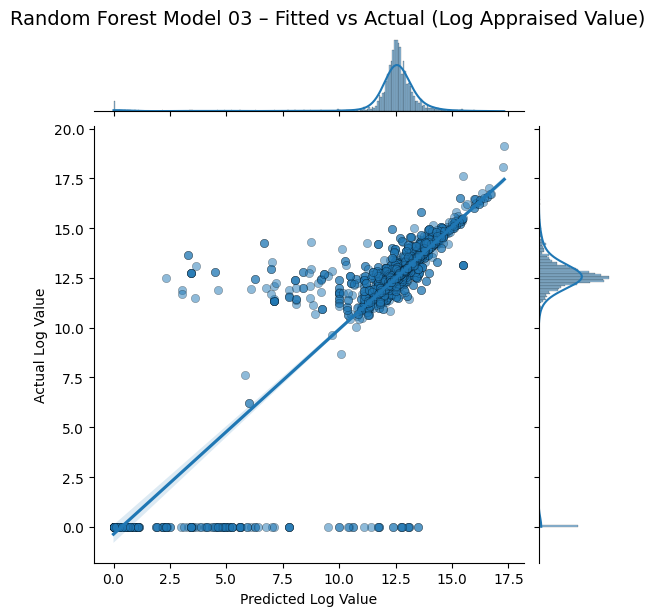

In [44]:
# Step 2: Create DataFrame for plotting
rf_plot_df = pd.DataFrame({
    "Actual Log Value": y_test,
    "Predicted Log Value": y_pred
})

# Step 3: Plot with seaborn
sns.jointplot(
    data=rf_plot_df,
    x="Predicted Log Value",
    y="Actual Log Value",
    kind="reg",
    height=6,
    scatter_kws={"alpha": 0.5, "edgecolor": "k", "linewidths": 0.3}
).set_axis_labels("Predicted Log Value", "Actual Log Value")

plt.suptitle("Random Forest Model 03 – Fitted vs Actual (Log Appraised Value)", y=1.02, fontsize=14)
plt.show()

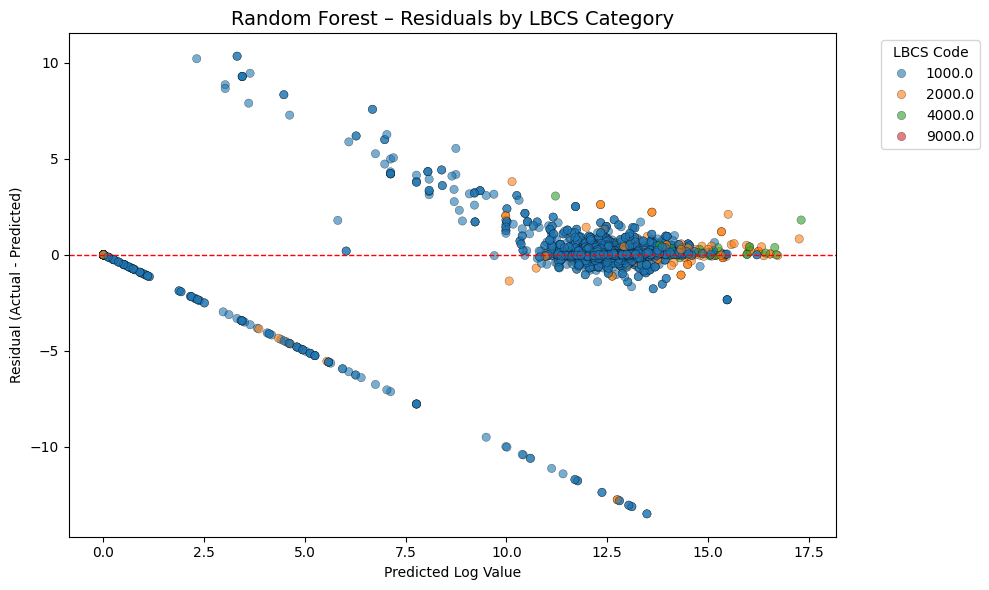

In [45]:
# Step 1: Build residuals DataFrame with LBCS info
residuals_df = X_test.copy()
residuals_df["Predicted Log Value"] = y_pred
residuals_df["Actual Log Value"] = y_test
residuals_df["Residual"] = y_test - y_pred
residuals_df["LBCS_Generalized_Code"] = df.loc[y_test.index, "LBCS_Generalized_Code"].astype(str)

# Step 2: Plot
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=residuals_df,
    x="Predicted Log Value",
    y="Residual",
    hue="LBCS_Generalized_Code",
    alpha=0.6,
    edgecolor="k",
    linewidth=0.3,
    palette="tab10"
)

plt.axhline(0, color="red", linestyle="--", linewidth=1)
plt.title("Random Forest – Residuals by LBCS Category", fontsize=14)
plt.xlabel("Predicted Log Value")
plt.ylabel("Residual (Actual - Predicted)")
plt.legend(title="LBCS Code", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

# M3 - Adjustments

In [59]:
# Prep storage
model_results = []
feature_importance_dfs = []
residuals_plot_df = []


In [60]:
# Stratified loop by LBCS code
for code, subset in df_corr.groupby("LBCS_Generalized_Code"):
    model_df = subset.copy()
    
    # Clean and prepare
    model_df["tot_appr_val"] = pd.to_numeric(model_df["tot_appr_val"], errors="coerce")
    model_df["yr_impr"] = pd.to_numeric(model_df["yr_impr"], errors="coerce")
    model_df["acreage"] = pd.to_numeric(model_df["acreage"], errors="coerce")
    model_df["Market_Area_1_Dscr"] = model_df["Market_Area_1_Dscr"].astype(str)
    model_df = model_df.dropna(subset=["tot_appr_val", "yr_impr", "acreage", "Market_Area_1_Dscr"])
    
    if len(model_df) < 30:
        print(f"LBCS {code}: Skipped (only {len(model_df)} records)")
        continue

    model_df["log_val"] = np.log1p(model_df["tot_appr_val"])
    
    # Feature matrix
    X = model_df[["yr_impr", "acreage", "Market_Area_1_Dscr"]]
    X = pd.get_dummies(X, drop_first=True)
    y = model_df["log_val"]
    
    # Train/test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
    
    rf = RandomForestRegressor(n_estimators=500, random_state=42, n_jobs=-1)
    rf.fit(X_train, y_train)
    y_pred = rf.predict(X_test)
    r2 = r2_score(y_test, y_pred)

    # Collect residuals for plotting
    residuals_df = pd.DataFrame({
    "Predicted": y_pred,
    "Actual": y_test,
    "Residual": y_test - y_pred,
    "LBCS_Code": code
    })
    residuals_plot_df.append(residuals_df)

    
    if pd.isna(r2):
        print(f"LBCS {code}: R² is undefined (likely too few samples). Skipping.")
        continue

    print(f"LBCS {code} — R²: {r2:.3f}")

    # Store metrics
    model_results.append({
        "LBCS_Code": code,
        "R2_Score": r2,
        "Test_Size": len(y_test),
        "Train_Size": len(y_train)
    })

    # Store feature importances
    importances = pd.Series(rf.feature_importances_, index=X_train.columns)
    fi_df = importances.reset_index()
    fi_df.columns = ["Feature", "Importance"]
    fi_df["LBCS_Code"] = code
    feature_importance_dfs.append(fi_df)


LBCS 1000.0 — R²: 0.759
LBCS 2000.0 — R²: 0.625
LBCS 4000.0 — R²: 0.763
LBCS 9000.0: Skipped (only 2 records)


In [61]:
m3_results_df = pd.DataFrame(model_results)
m3_featureimp_df = pd.concat(feature_importance_dfs, ignore_index=True)

## M3 - Stats

C:\Users\17138\AppData\Local\Temp\ipykernel_11212\213280077.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=m3_results_df, x="LBCS_Code", y="R2_Score", palette="Set2")


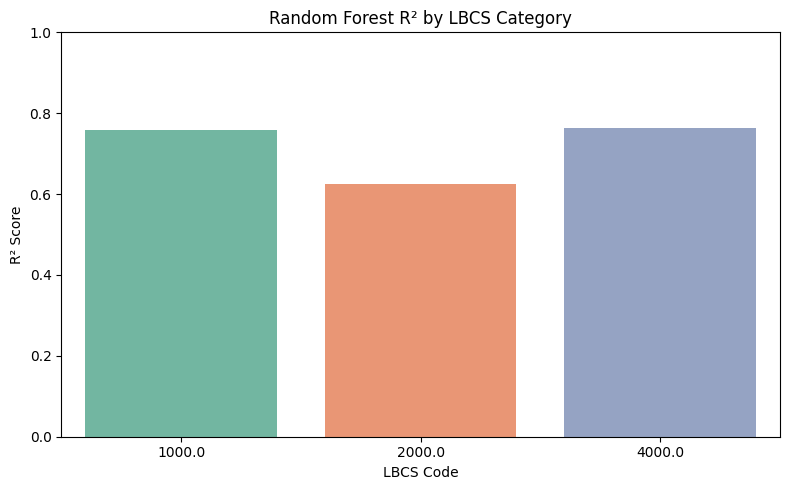

In [62]:
# R² by LBCS
plt.figure(figsize=(8, 5))
sns.barplot(data=m3_results_df, x="LBCS_Code", y="R2_Score", palette="Set2")
plt.title("Random Forest R² by LBCS Category")
plt.ylabel("R² Score")
plt.xlabel("LBCS Code")
plt.ylim(0, 1)
plt.tight_layout()
plt.savefig("OUTPUT/rf_r2_by_lbcscode.png", dpi=300)
plt.show()

C:\Users\17138\AppData\Local\Temp\ipykernel_11212\893472728.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_feats = m3_featureimp_df.groupby("LBCS_Code").apply(


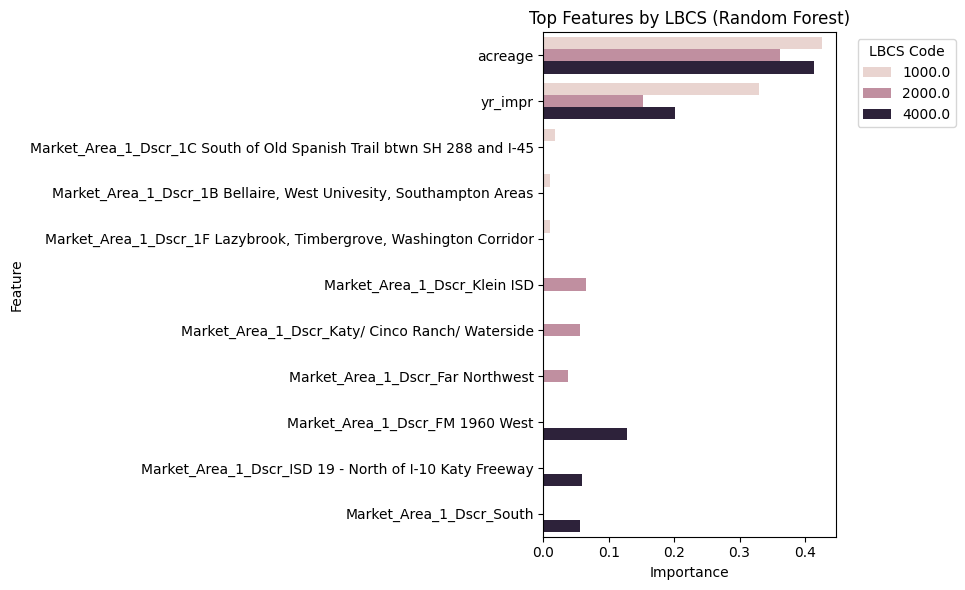

In [63]:
# Top features per LBCS
top_feats = m3_featureimp_df.groupby("LBCS_Code").apply(
    lambda g: g.sort_values("Importance", ascending=False).head(5)
).reset_index(drop=True)

plt.figure(figsize=(10, 6))
sns.barplot(data=top_feats, x="Importance", y="Feature", hue="LBCS_Code")
plt.title("Top Features by LBCS (Random Forest)")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left", title="LBCS Code")
plt.tight_layout()
plt.savefig("OUTPUT/rf_top_features_by_lbcscode.png", dpi=300)
plt.show()

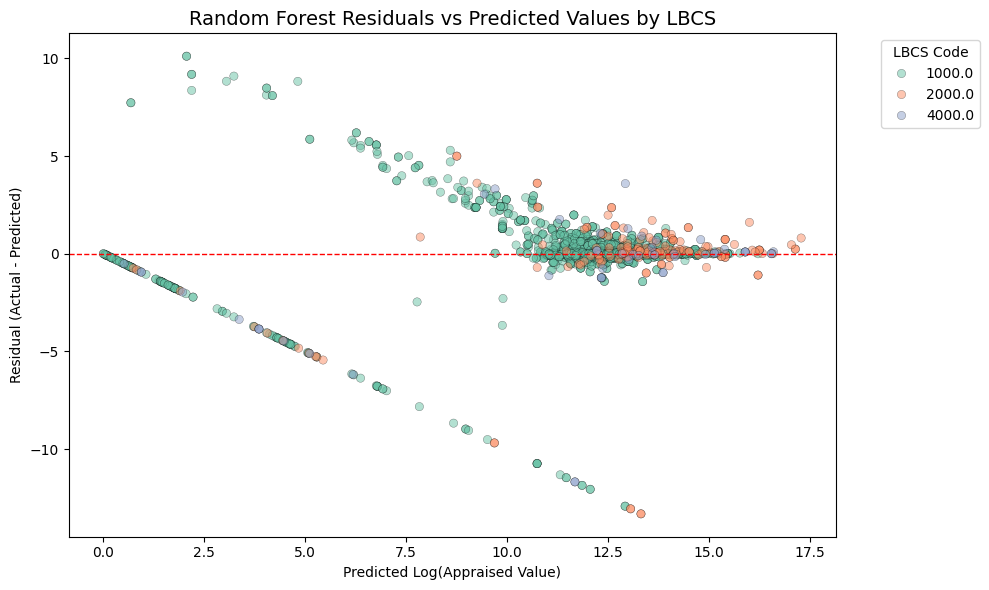

In [64]:
# Combine residuals from all models
all_residuals_df = pd.concat(residuals_plot_df, ignore_index=True)

# Plot residuals vs predicted
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=all_residuals_df,
    x="Predicted",
    y="Residual",
    hue="LBCS_Code",
    alpha=0.5,
    edgecolor="k",
    linewidth=0.3,
    palette="Set2"
)
plt.axhline(0, color="red", linestyle="--", linewidth=1)
plt.title("Random Forest Residuals vs Predicted Values by LBCS", fontsize=14)
plt.xlabel("Predicted Log(Appraised Value)")
plt.ylabel("Residual (Actual - Predicted)")
plt.legend(title="LBCS Code", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.savefig("OUTPUT/rf_residuals_vs_predicted.png", dpi=300)
plt.show()
